In [1]:
%run supportvectors-common.ipynb



<div style="color:#aaa;font-size:8pt">
<hr/>

 </blockquote>
 <hr/>
</div>



# Exploratory data analysis for the housing dataset

In [2]:
data = pd.read_csv("https://raw.githubusercontent.com/supportvectors/ml-100/master/housing.csv") # reading and storing the dataset in a pandas dataframe

In [3]:
data.describe(include='all').transpose()

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
longitude,20640.0,NaN,NaN,NaN,-119.569704,2.003532,-124.35,-121.8,-118.49,-118.01,-114.31
latitude,20640.0,NaN,NaN,NaN,35.631861,2.135952,32.54,33.93,34.26,37.71,41.95
housing_median_age,20640.0,NaN,NaN,NaN,28.639486,12.585558,1.0,18.0,29.0,37.0,52.0
total_rooms,20640.0,NaN,NaN,NaN,2635.763081,2181.615252,2.0,1447.75,2127.0,3148.0,39320.0
total_bedrooms,20433.0,NaN,NaN,NaN,537.870553,421.38507,1.0,296.0,435.0,647.0,6445.0
population,20640.0,NaN,NaN,NaN,1425.476744,1132.462122,3.0,787.0,1166.0,1725.0,35682.0
households,20640.0,NaN,NaN,NaN,499.53968,382.329753,1.0,280.0,409.0,605.0,6082.0
median_income,20640.0,NaN,NaN,NaN,3.870671,1.899822,0.4999,2.5634,3.5348,4.74325,15.0001
median_house_value,20640.0,NaN,NaN,NaN,206855.816909,115395.615874,14999.0,119600.0,179700.0,264725.0,500001.0
ocean_proximity,20640,5,<1H OCEAN,9136,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Missing Value Analysis

Let us study the severity of missing values for each of the features.

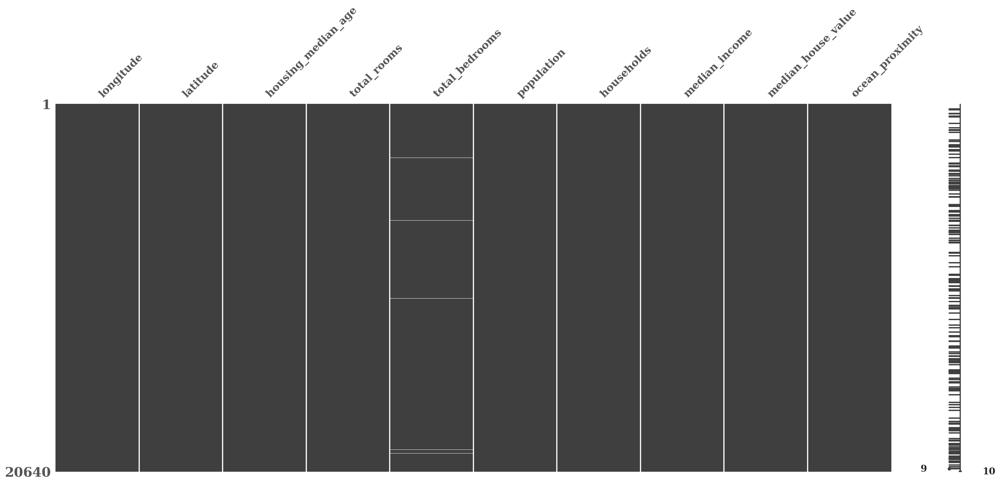

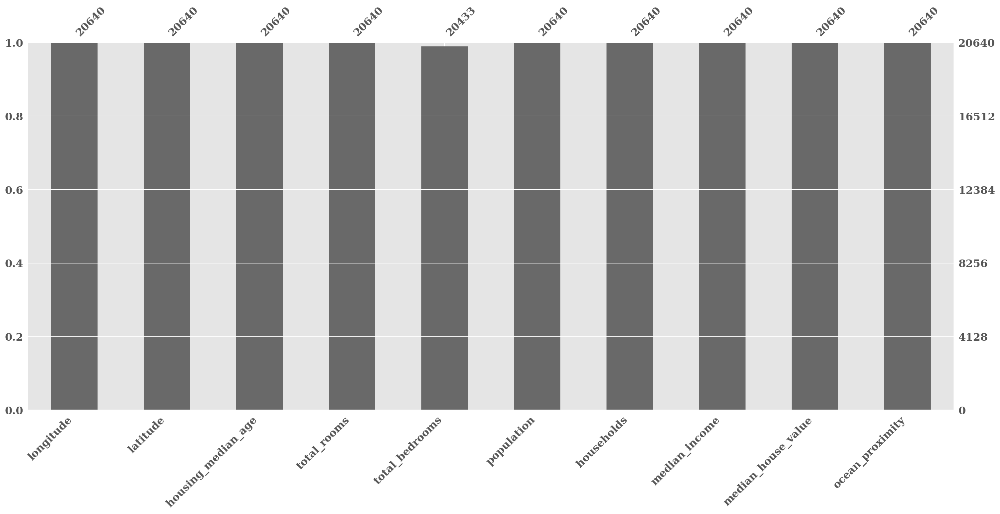

In [4]:
# Missingno library breaks with latex, so we will temporarily turn it off.
rc ('text', usetex=False)
import missingno as msno
msno.matrix(data);
plt.show()
msno.bar(data);
plt.show()


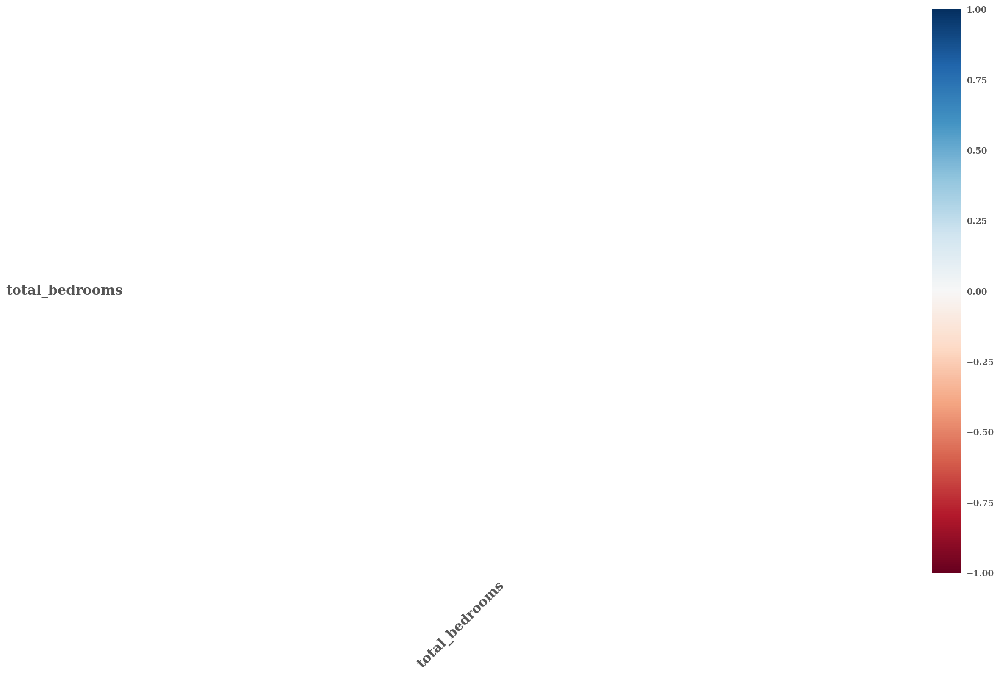

In [5]:
msno.heatmap(data);

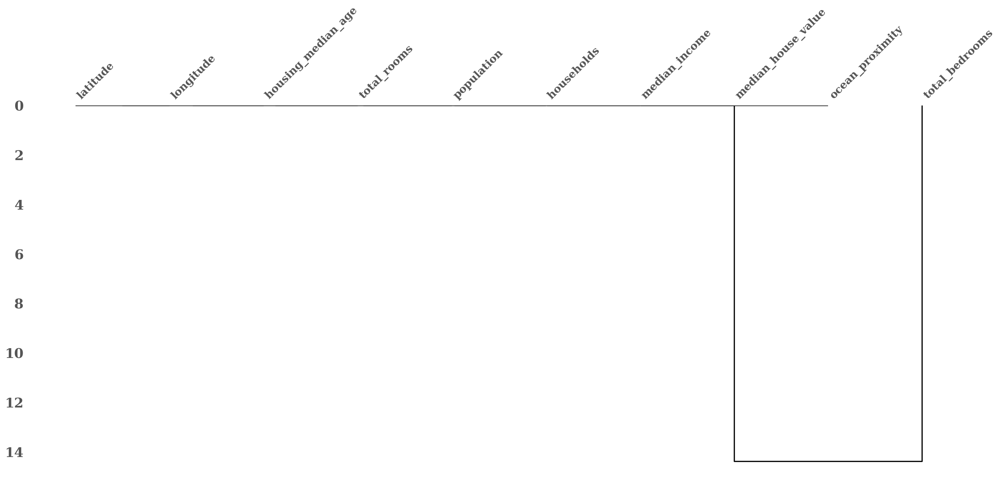

In [6]:
msno.dendrogram(data);

## Drop missing values for now

In [7]:
# Since very few rows have missing total-bedroom feature, let us drop those rows.

data.dropna(inplace=True)

In [8]:
rc ('text', usetex=False) # Re-enable it.

 ## Draw the map of California

In [9]:

import folium
plt.rcParams['figure.figsize'] = '10,10'

# Find the center of california
max_x, min_x      = data['longitude'].max(), data['longitude'].min()
max_y, min_y      = data['latitude'].max(), data['latitude'].min()
center_longitude, center_latitude   = (max_x+min_x)/2, (max_y+min_y)/2

# Plot the map of California
m = folium.Map(location=[center_latitude, center_longitude], zoom_start=5.5)


for index, row in data.iterrows():
    folium.Circle(
    radius=3,
    location=[row.latitude, row.longitude],
    color='#E74C3C',
    opacity=0.05,
    fill=False,
    ).add_to(m)

m

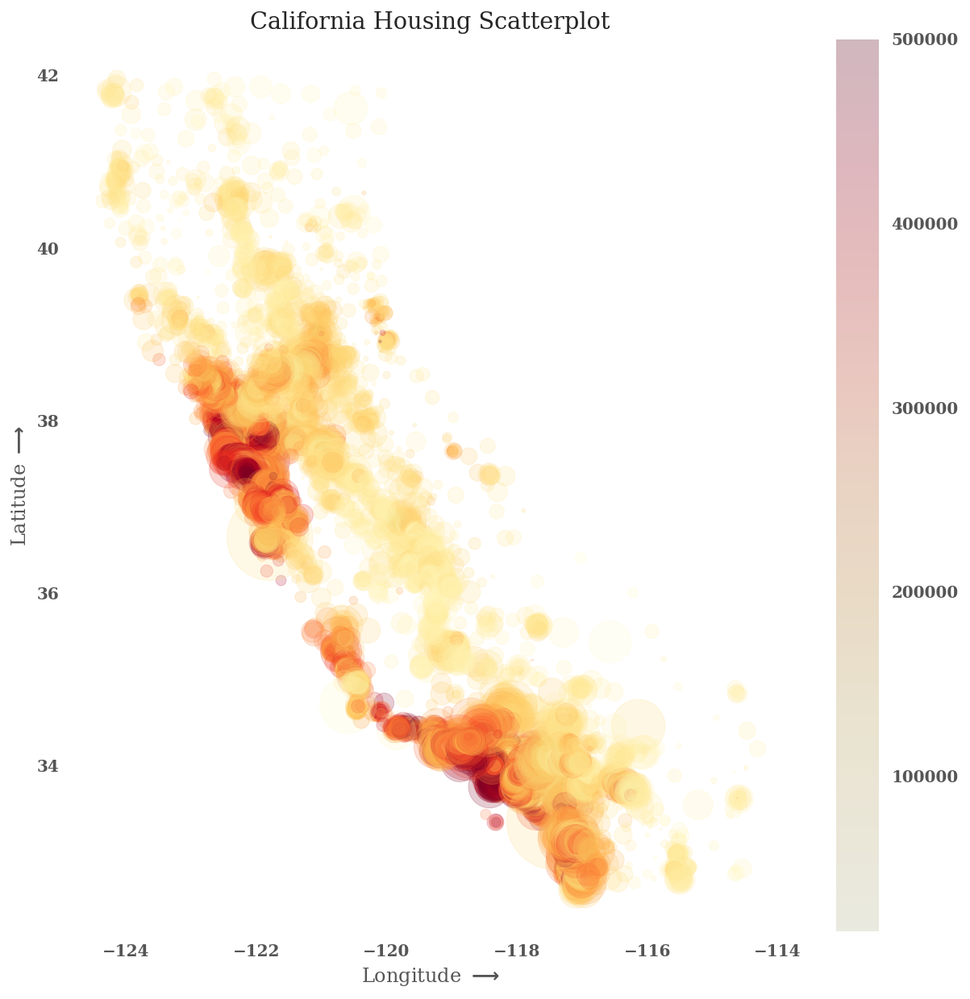

In [10]:



plt.scatter(x    = data.longitude, 
            y    = data.latitude, 
            c    = data.median_house_value, 
            cmap = 'YlOrRd', 
            s    = data.population/10, 
            alpha= 0.2);
ax = plt.gca();
ax.set_facecolor('#FFFFFF')
plt.xlabel(r'Longitude $\longrightarrow$')
plt.ylabel(r'Latitude $\longrightarrow$')
plt.title(r'California Housing Scatterplot')

plt.colorbar();

In [11]:
import matplotlib.image as mpimg

img1 = mpimg.imread('california-housing-map.png')
img2 = mpimg.imread('california-housing-scatterplot.png')

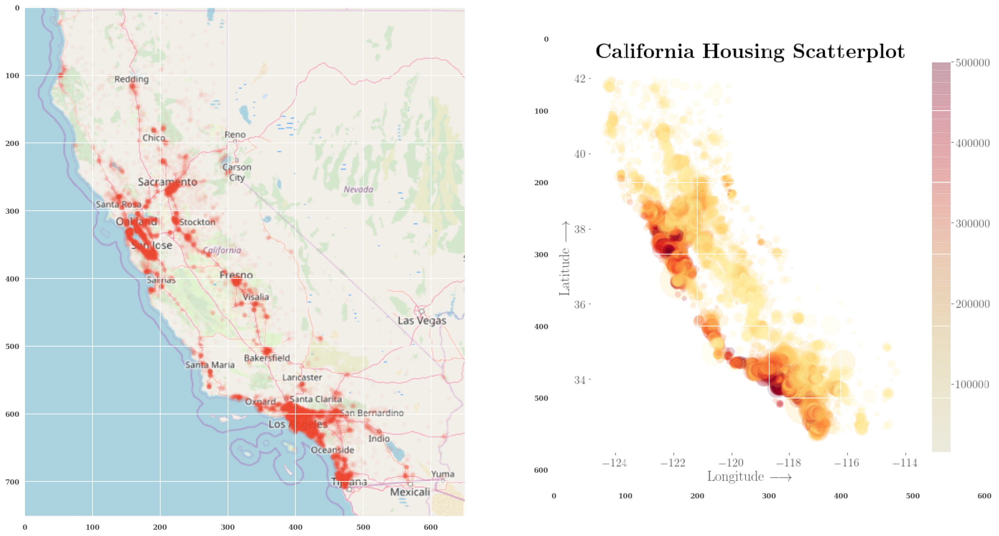

In [12]:
plt.rcParams['figure.figsize'] = '25,25'

plt.figure(1)
plt.title(r'\textbf{California Housing}')

plt.subplot(121);
plt.imshow(img1);

plt.subplot(122);
plt.imshow(img2);



In [13]:
data.ocean_proximity = data.ocean_proximity.astype('category')

In [14]:
data.describe(include='all').transpose()

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
longitude,20433.0,NaN,NaN,NaN,-119.570689,2.003578,-124.35,-121.8,-118.49,-118.01,-114.31
latitude,20433.0,NaN,NaN,NaN,35.633221,2.136348,32.54,33.93,34.26,37.72,41.95
housing_median_age,20433.0,NaN,NaN,NaN,28.633094,12.591805,1.0,18.0,29.0,37.0,52.0
total_rooms,20433.0,NaN,NaN,NaN,2636.504233,2185.269567,2.0,1450.0,2127.0,3143.0,39320.0
total_bedrooms,20433.0,NaN,NaN,NaN,537.870553,421.38507,1.0,296.0,435.0,647.0,6445.0
population,20433.0,NaN,NaN,NaN,1424.946949,1133.20849,3.0,787.0,1166.0,1722.0,35682.0
households,20433.0,NaN,NaN,NaN,499.433465,382.299226,1.0,280.0,409.0,604.0,6082.0
median_income,20433.0,NaN,NaN,NaN,3.871162,1.899291,0.4999,2.5637,3.5365,4.744,15.0001
median_house_value,20433.0,NaN,NaN,NaN,206864.413155,115435.667099,14999.0,119500.0,179700.0,264700.0,500001.0
ocean_proximity,20433,5,<1H OCEAN,9034,NaN,NaN,NaN,NaN,NaN,NaN,NaN


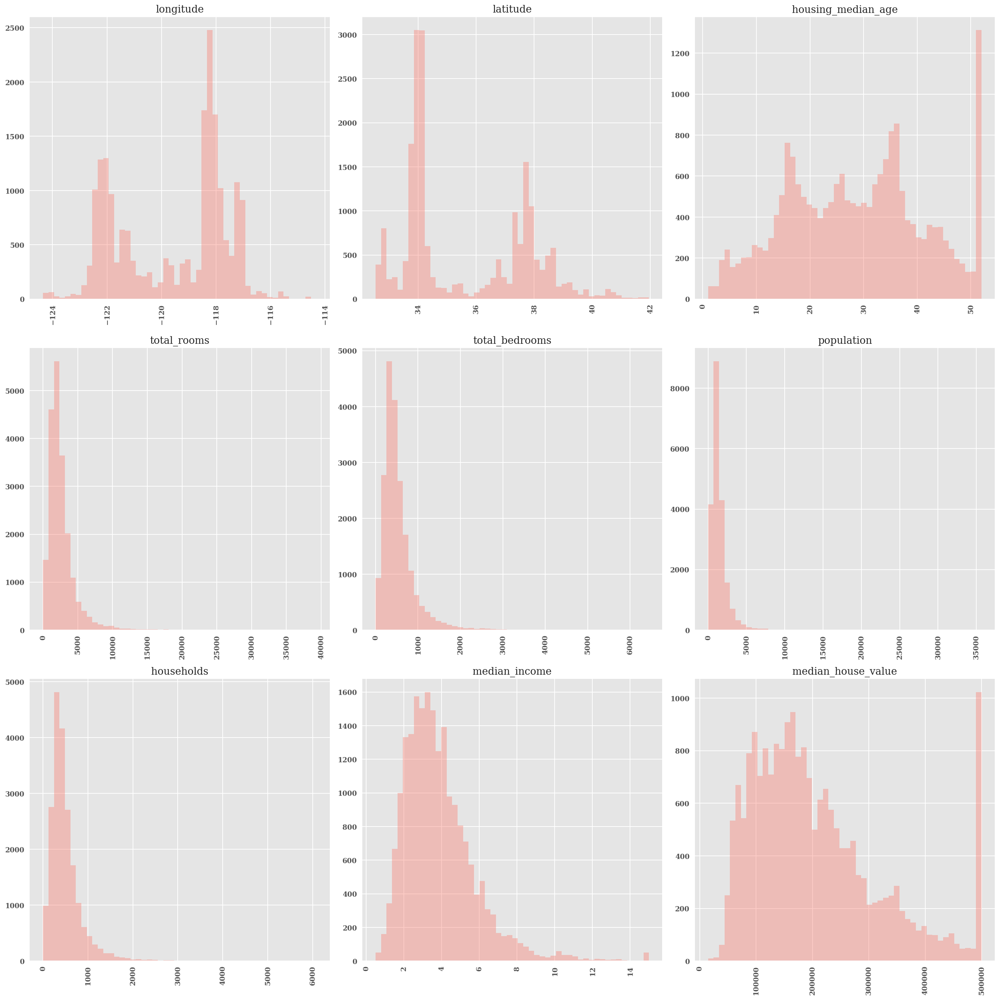

In [15]:
rc('text', usetex=False)
data.hist(bins=50, alpha = 0.4, color='salmon', xrot=90, figsize=(20,20));
plt.tight_layout()

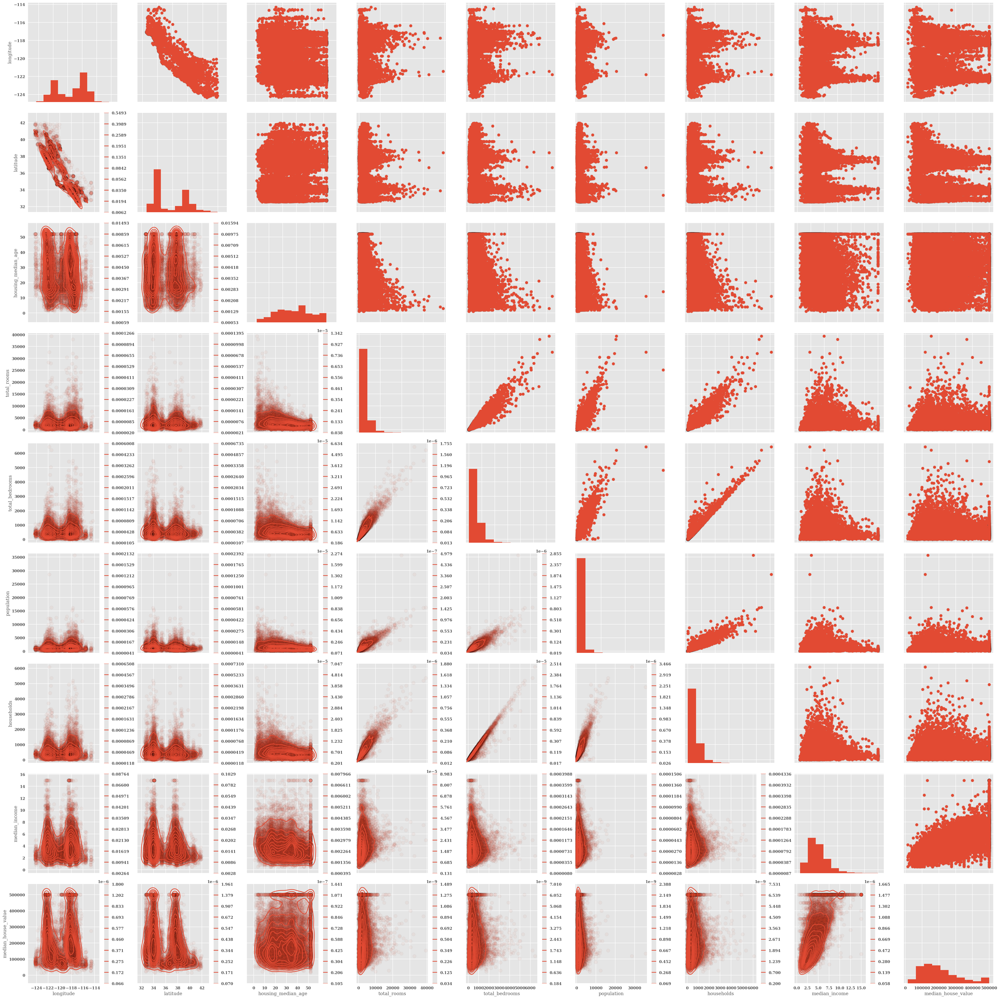

In [16]:

sample = data
fig = sns.pairplot(sample, 
                   plot_kws = {'alpha': 0.05, 's': 80, 'edgecolor': 'k'}, 
                   size=4, );
fig.map_diag(plt.hist);
fig.map_upper(plt.scatter);
fig.map_lower(sns.kdeplot, shade=False, cbar=True);
plt.tight_layout()

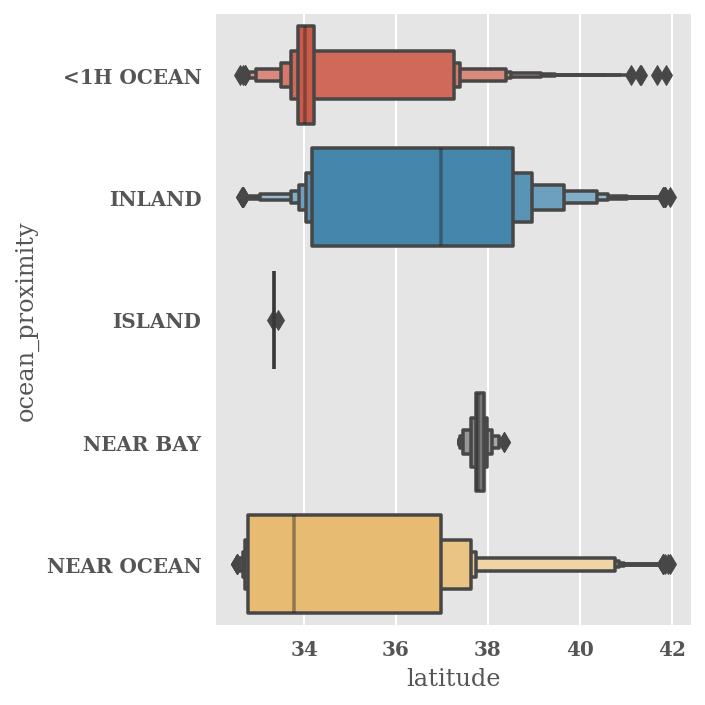

In [17]:
plt.rcParams['figure.figsize'] = '5,5'
sns.catplot(x="latitude", y="ocean_proximity", kind="boxen",
            data=data.sort_values("ocean_proximity"));

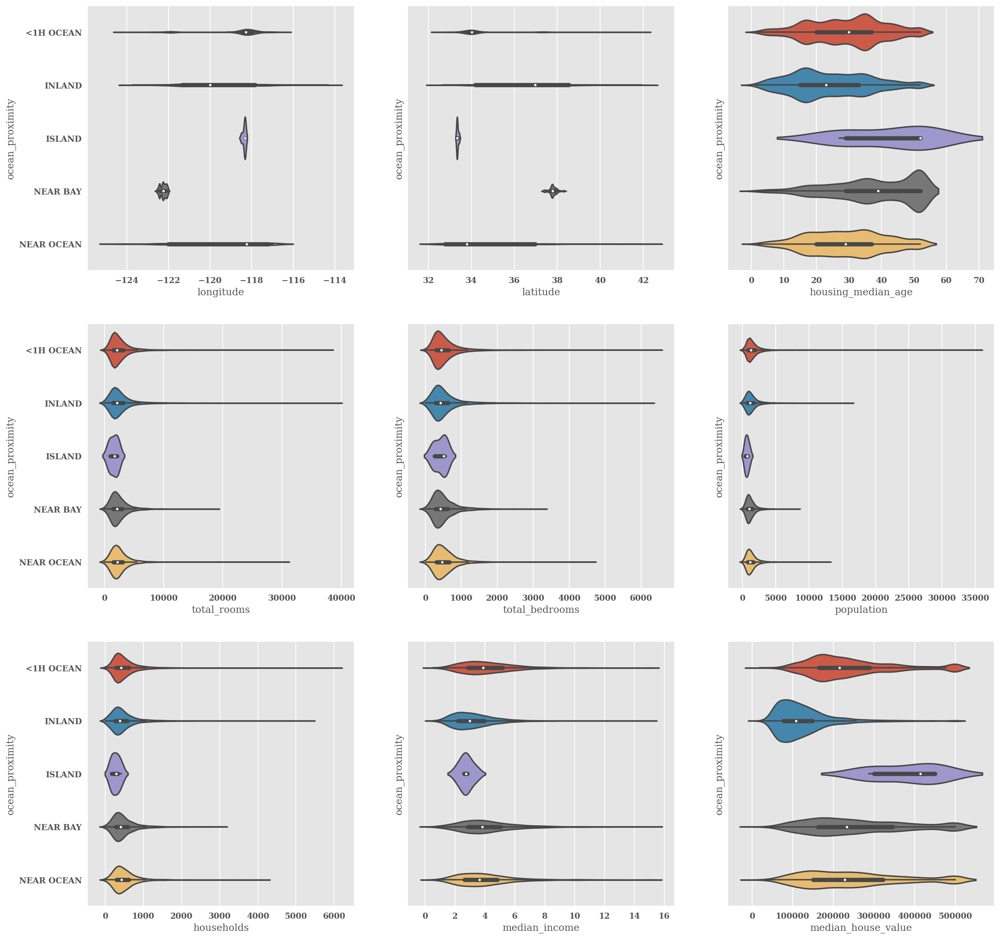

In [18]:
features = data.columns.tolist()
features.remove('ocean_proximity') # it is a categorical

# Because there are 9 numerical features
fig, axes = plt.subplots(3,3, sharey=True, figsize=(20,20))


for i in range(9):
    sns.violinplot(  y    = 'ocean_proximity', 
                     x    = features[i], 
                     data = data,ax=axes[int(i/3), i%3], figsize=(8,8))



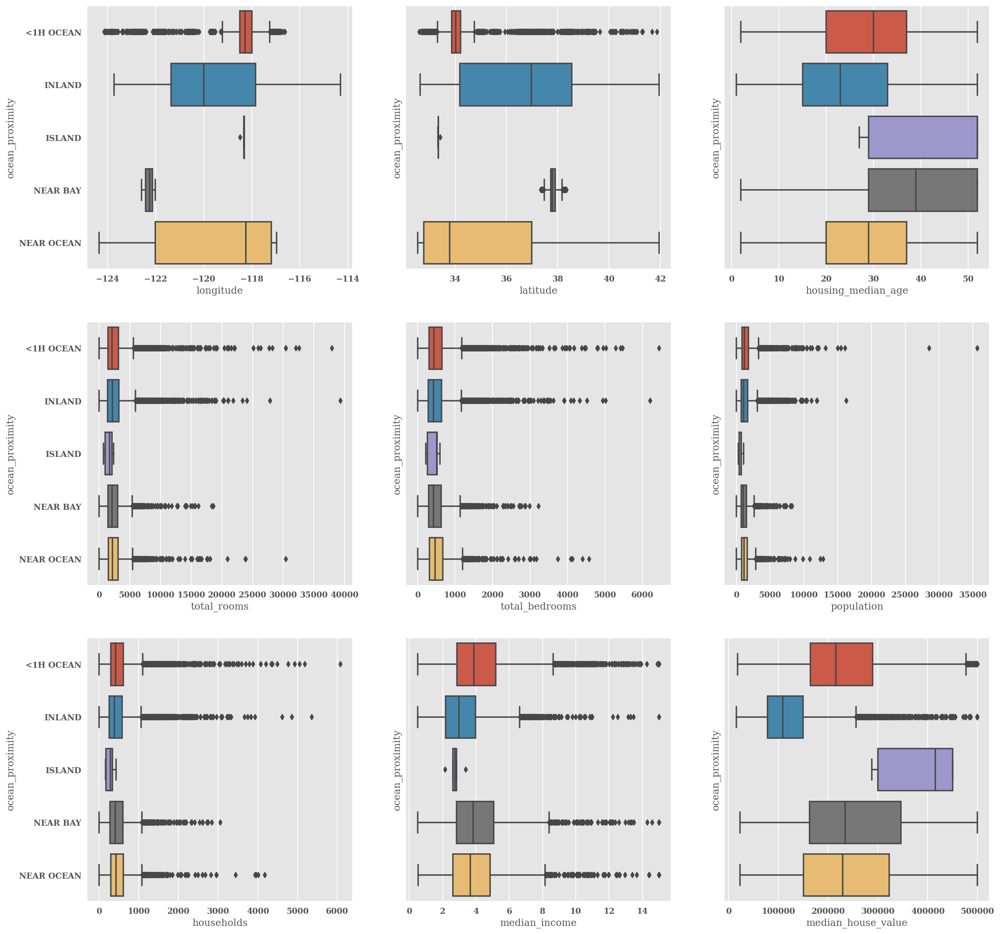

In [19]:
features = data.columns.tolist()
features.remove('ocean_proximity') # it is a categorical

fig, axes = plt.subplots(3,3, sharey=True, figsize=(20,20))

for i in range(9):
    sns.boxplot(  y='ocean_proximity', x = features[i], data=data,ax=axes[int(i/3), i%3] )

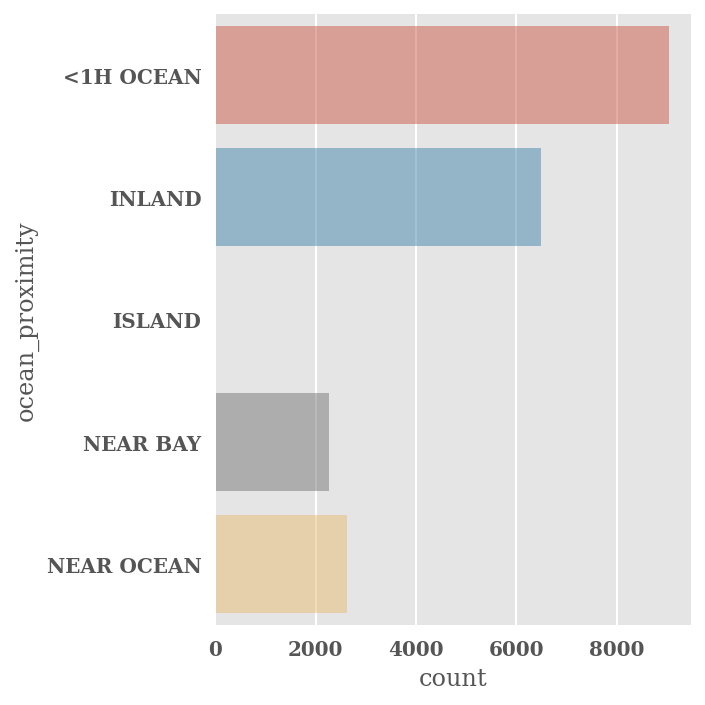

In [20]:
sns.catplot(y="ocean_proximity", kind="count",  alpha=0.5, data=data);

In [21]:
corr = data.drop(columns=['ocean_proximity']).corr()
corr

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
longitude,1.000000,-0.924616,-0.109357,0.045480,0.069608,0.100270,0.056513,-0.015550,-0.045398
latitude,-0.924616,1.000000,0.011899,-0.036667,-0.066983,-0.108997,-0.071774,-0.079626,-0.144638
housing_median_age,-0.109357,0.011899,1.000000,-0.360628,-0.320451,-0.295787,-0.302768,-0.118278,0.106432
total_rooms,0.045480,-0.036667,-0.360628,1.000000,0.930380,0.857281,0.918992,0.197882,0.133294
total_bedrooms,0.069608,-0.066983,-0.320451,0.930380,1.000000,0.877747,0.979728,-0.007723,0.049686
population,0.100270,-0.108997,-0.295787,0.857281,0.877747,1.000000,0.907186,0.005087,-0.025300
households,0.056513,-0.071774,-0.302768,0.918992,0.979728,0.907186,1.000000,0.013434,0.064894
median_income,-0.015550,-0.079626,-0.118278,0.197882,-0.007723,0.005087,0.013434,1.000000,0.688355
median_house_value,-0.045398,-0.144638,0.106432,0.133294,0.049686,-0.025300,0.064894,0.688355,1.000000


In [22]:
# to get the latex output for the document.
print(corr.to_latex())

\begin{tabular}{lrrrrrrrrr}
\toprule
 & longitude & latitude & housing_median_age & total_rooms & total_bedrooms & population & households & median_income & median_house_value \\
\midrule
longitude & 1.000000 & -0.924616 & -0.109357 & 0.045480 & 0.069608 & 0.100270 & 0.056513 & -0.015550 & -0.045398 \\
latitude & -0.924616 & 1.000000 & 0.011899 & -0.036667 & -0.066983 & -0.108997 & -0.071774 & -0.079626 & -0.144638 \\
housing_median_age & -0.109357 & 0.011899 & 1.000000 & -0.360628 & -0.320451 & -0.295787 & -0.302768 & -0.118278 & 0.106432 \\
total_rooms & 0.045480 & -0.036667 & -0.360628 & 1.000000 & 0.930380 & 0.857281 & 0.918992 & 0.197882 & 0.133294 \\
total_bedrooms & 0.069608 & -0.066983 & -0.320451 & 0.930380 & 1.000000 & 0.877747 & 0.979728 & -0.007723 & 0.049686 \\
population & 0.100270 & -0.108997 & -0.295787 & 0.857281 & 0.877747 & 1.000000 & 0.907186 & 0.005087 & -0.025300 \\
households & 0.056513 & -0.071774 & -0.302768 & 0.918992 & 0.979728 & 0.907186 & 1.000000 & 0.01343

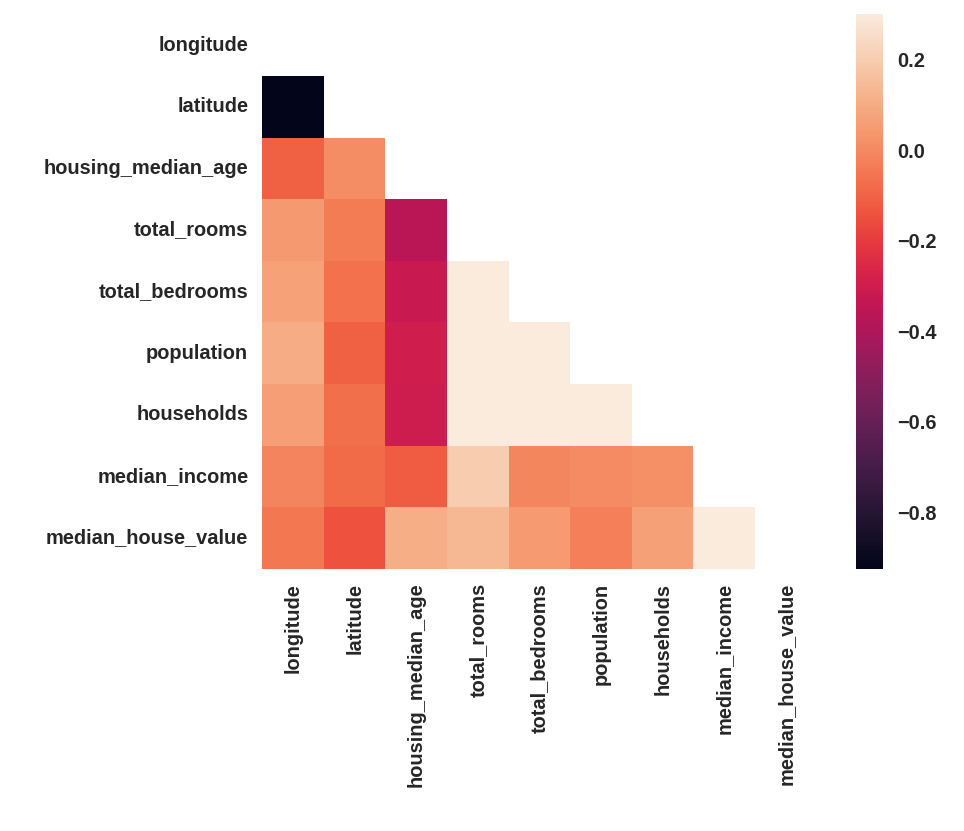

In [23]:
import numpy as np
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True
with sns.axes_style("white"):
    f, ax = plt.subplots(figsize=(7, 5))
    ax = sns.heatmap(corr, mask=mask, vmax=.3, square=True)

# Basic Regression Model

Let us now build a regression model using RandomForest for the housing dataset. To do this, let us first prepare teh dataset for analysis

## Data Preprocessing

Here we perform the two steps:
* convert the categorical to one-hot encoding
* drop the missing values
* extract out the feature-space X, and the target (label) variable. 

In [24]:
data_one_hot = pd.get_dummies(data, 
                              columns=['ocean_proximity'], 
                              prefix = ['ocean_proximity'])
data_one_hot.dropna(inplace=True) 
y = data_one_hot.median_house_value
X = data_one_hot.drop('median_house_value', axis=1)

X.describe(include='all').transpose()

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
longitude,20433.0,NaN,NaN,NaN,-119.570689,2.003578,-124.35,-121.8,-118.49,-118.01,-114.31
latitude,20433.0,NaN,NaN,NaN,35.633221,2.136348,32.54,33.93,34.26,37.72,41.95
housing_median_age,20433.0,NaN,NaN,NaN,28.633094,12.591805,1.0,18.0,29.0,37.0,52.0
total_rooms,20433.0,NaN,NaN,NaN,2636.504233,2185.269567,2.0,1450.0,2127.0,3143.0,39320.0
total_bedrooms,20433.0,NaN,NaN,NaN,537.870553,421.38507,1.0,296.0,435.0,647.0,6445.0
population,20433.0,NaN,NaN,NaN,1424.946949,1133.20849,3.0,787.0,1166.0,1722.0,35682.0
households,20433.0,NaN,NaN,NaN,499.433465,382.299226,1.0,280.0,409.0,604.0,6082.0
median_income,20433.0,NaN,NaN,NaN,3.871162,1.899291,0.4999,2.5637,3.5365,4.744,15.0001
ocean_proximity_<1H OCEAN,20433,2,False,11399,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ocean_proximity_INLAND,20433,2,False,13937,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Log transform
We noticed before that some of the features show a strong right skew. In order to address it, let us take a log-transform in order to try to make them look a bit more symmetrical.

In [25]:
X.total_bedrooms = np.log(X.total_bedrooms)
X.population = np.log(X.population)
X.total_rooms = np.log(X.total_rooms)
X.households = np.log(X.households)
X.median_income = np.log(X.median_income)
y = np.log(y)
X.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
longitude,20433.0,-119.570689,2.003578,-124.350000,-121.800000,-118.490000,-118.010000,-114.310000
latitude,20433.0,35.633221,2.136348,32.540000,33.930000,34.260000,37.720000,41.950000
housing_median_age,20433.0,28.633094,12.591805,1.000000,18.000000,29.000000,37.000000,52.000000
total_rooms,20433.0,7.628742,0.751814,0.693147,7.279319,7.662468,8.052933,10.579489
total_bedrooms,20433.0,6.051063,0.732785,0.000000,5.690359,6.075346,6.472346,8.771060
population,20433.0,7.023732,0.738632,1.098612,6.668228,7.061334,7.451242,10.482402
households,20433.0,5.980637,0.733216,0.000000,5.634790,6.013715,6.403574,8.713089
median_income,20433.0,1.244626,0.470637,-0.693347,0.941452,1.263138,1.556881,2.708057


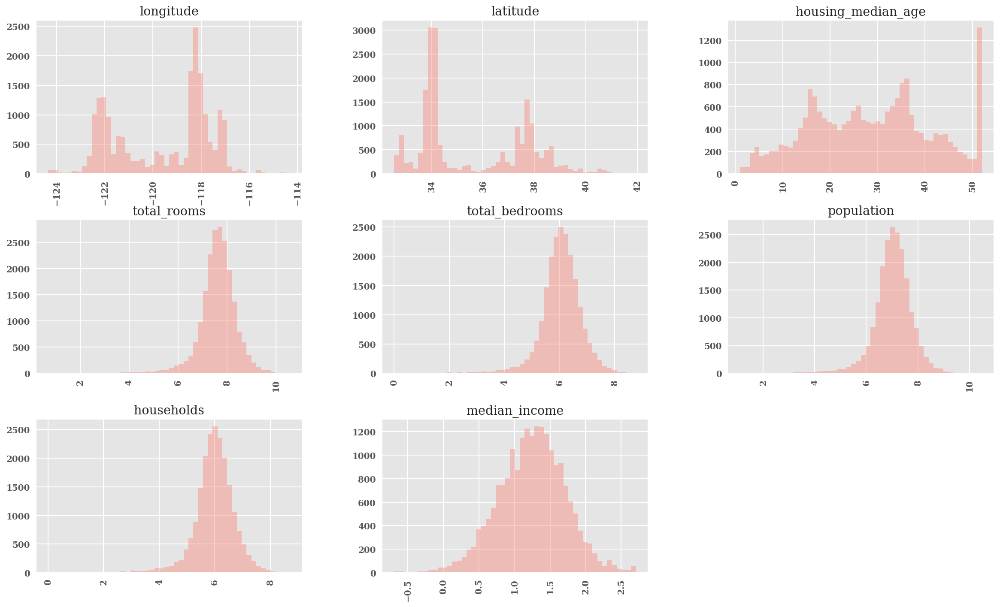

In [26]:
rc('text', usetex=False)
X.hist(bins=50, alpha = 0.4, color='salmon', xrot=90, figsize=(20,20), layout=(5,3));

## Data split into train and test

In [27]:
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0, )

## Simple linear regression model 

Let us build a baseline linear regression model with this data:

In [28]:

linear_model = LinearRegression()
linear_model.fit(X_train, y_train)
labels = linear_model.predict(X_test)

# Check how good are the predictions?
mse         = mean_squared_error(y_test, labels)
print(f"Mean squared error: {mse:.2f}")
r2 = r2_score(y_test, labels)
print(rf"Coefficient of Determination (R^2):{r2:0.4f}")
print(rf'Model coefficients are: {linear_model.coef_}')


Mean squared error: 0.10
Coefficient of Determination (R^2):0.6911
Model coefficients are: [-0.16538399 -0.16407788  0.00301923 -0.19099691  0.41382609 -0.37242703
  0.16891577  0.76365496 -0.05401582 -0.3199041   0.57082991 -0.09627221
 -0.10063778]


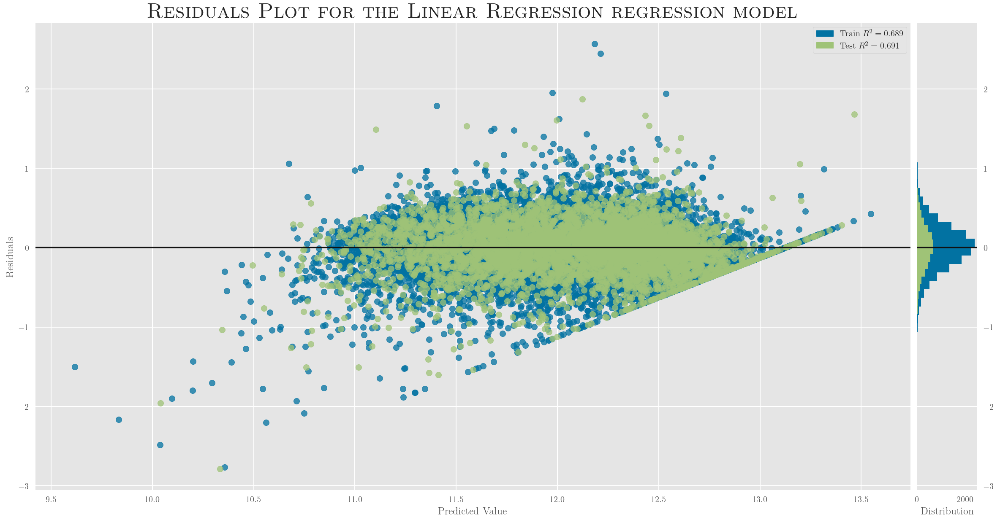

In [29]:
rc ('text', usetex=True) # Enable it selectively
from yellowbrick.regressor import residuals_plot
plt.rcParams[ 'figure.figsize' ] = '20,10'               # landscape format figures
viz = residuals_plot(linear_model, X_train, y_train, X_test, y_test, 
                     title=r'\textsc{\Huge Residuals Plot for the Linear Regression regression model}')

### Prediction Errors Plot

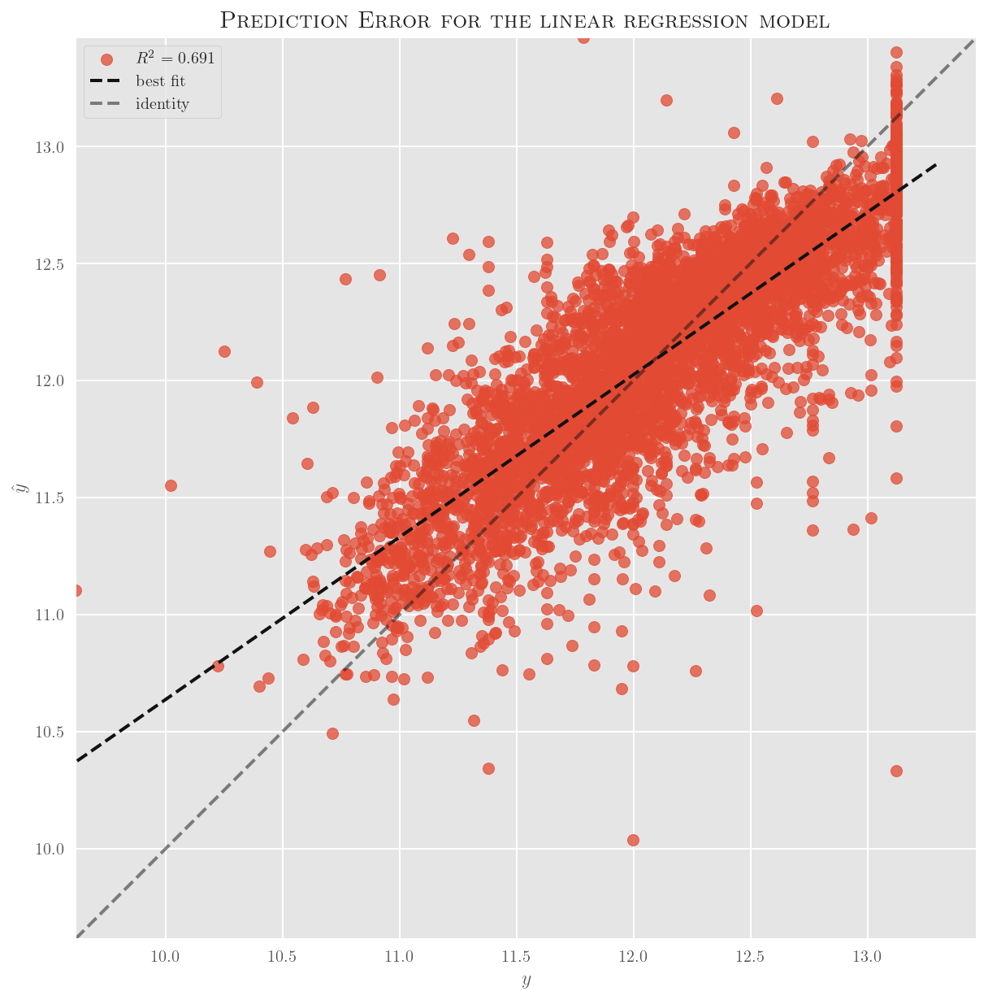

In [30]:
from yellowbrick.regressor import prediction_error

visualizer = prediction_error(linear_model, X_train, y_train, X_test, y_test,
                             title=r'\textsc{\Large Prediction Error for the linear regression model}',
                             xlabel=r'$\mathbf{y}$', ylabel=r'$\mathbf{\hat{y}}$')

## Would regularlization help?
Would regularizaton using say Ridge-Regularization for the regression give us a better result? Think about it for a moment: is this a simple model, or a complex one?

See if the below supports your guess? Explain the results.

In [31]:
from sklearn.linear_model import RidgeCV
ridge_model = RidgeCV(alphas=[1e-3, 1e-2, 1e-1, 1]).fit(X_train, y_train)

labels = ridge_model.predict(X_test)

# Check how good are the predictions?
mse         = mean_squared_error(y_test, labels)
print(f"Mean squared error: {mse:.2f}")
r2 = r2_score(y_test, labels)
print(rf"Coefficient of Determination (R^2):{r2:0.4f}")
print(rf'Model coefficients are: {ridge_model.coef_}')

Mean squared error: 0.10
Coefficient of Determination (R^2):0.6912
Model coefficients are: [-0.1654036  -0.16410165  0.0030193  -0.19076031  0.4136164  -0.37241136
  0.1688773   0.76352731 -0.05030601 -0.31620123  0.55599364 -0.09255258
 -0.09693382]


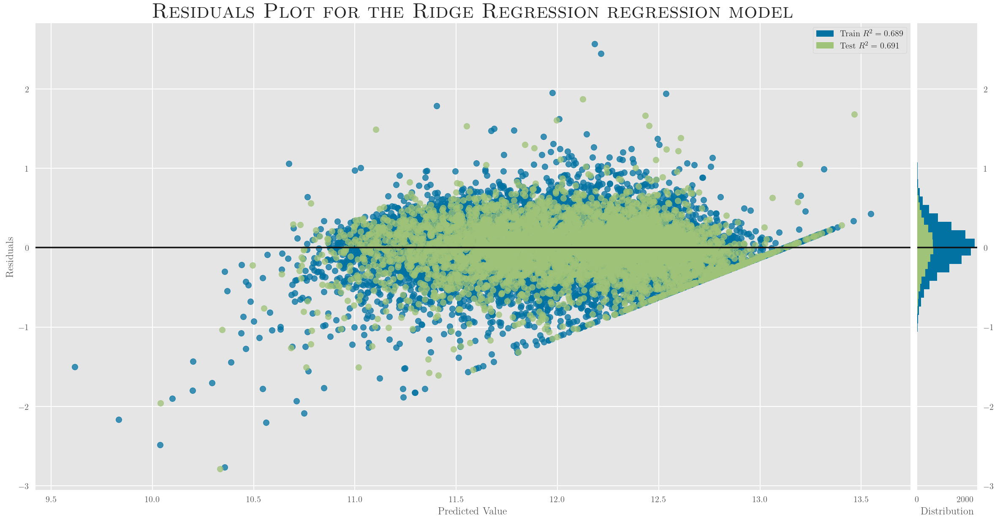

In [32]:
from yellowbrick.regressor import residuals_plot
plt.rcParams[ 'figure.figsize' ] = '20,10'               # landscape format figures
viz = residuals_plot(ridge_model, X_train, y_train, X_test, y_test, 
                     title=r'\textsc{\Huge Residuals Plot for the Ridge Regression regression model}')

### Prediction Errors Plot

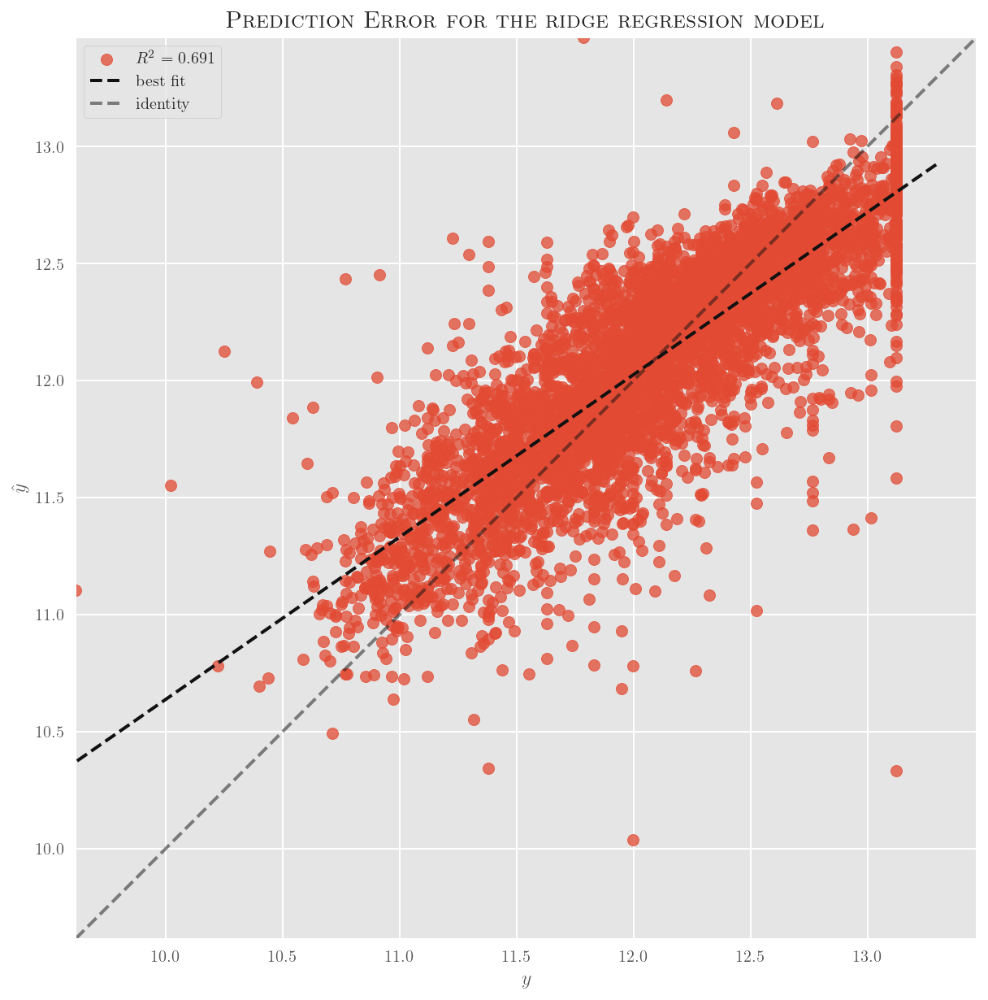

In [33]:
from yellowbrick.regressor import prediction_error

visualizer = prediction_error(ridge_model, X_train, y_train, X_test, y_test,
                             title=r'\textsc{\Large Prediction Error for the ridge regression model}',
                             xlabel=r'$\mathbf{y}$', ylabel=r'$\mathbf{\hat{y}}$')

## Using Decision Tree regressor
Let us now apply the decision tree regressor to this dataset

In [34]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.tree import export_graphviz  
tree_model = DecisionTreeRegressor(max_depth=5, random_state=42,).fit(X_train, y_train)

labels = tree_model.predict(X_test)

# Check how good are the predictions?
mse         = mean_squared_error(y_test, labels)
print(f"Mean squared error: {mse:.2f}")
r2 = r2_score(y_test, labels)
print(rf"Coefficient of Determination (R^2):{r2:0.4f}")

Mean squared error: 0.10
Coefficient of Determination (R^2):0.6772


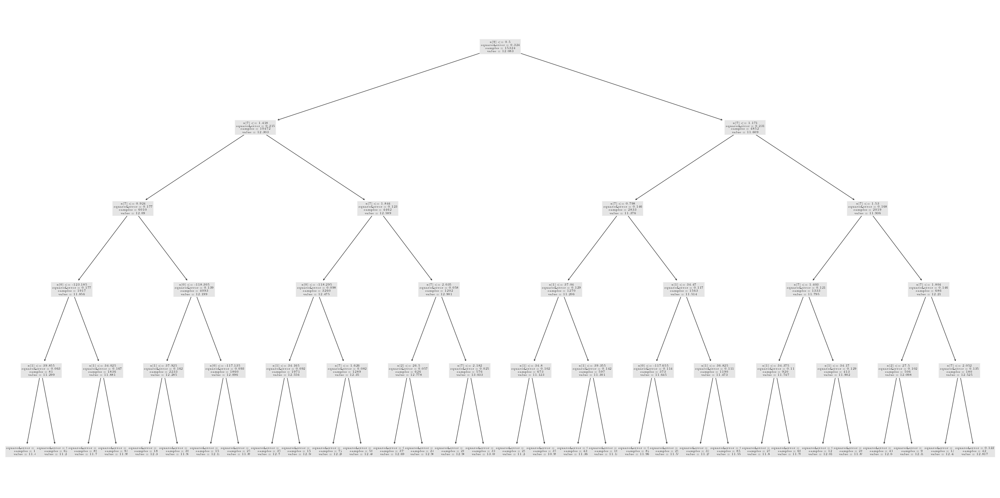

In [35]:
from sklearn.tree import plot_tree
plot_tree(tree_model);

In [36]:
import graphviz
dot_data = export_graphviz(tree_model, out_file=None, 
                           filled=True, rounded=True,  
                           special_characters=True)  
graph = graphviz.Source(dot_data)
graph.render("CaliforniaHousing") 
#graph 

'CaliforniaHousing.pdf'

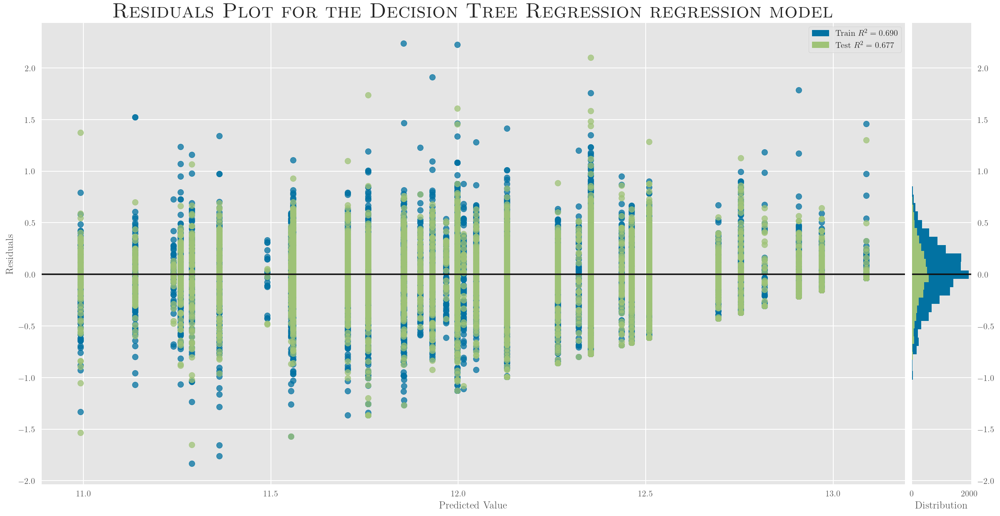

In [37]:
from yellowbrick.regressor import residuals_plot
plt.rcParams[ 'figure.figsize' ] = '20,10'               # landscape format figures
viz = residuals_plot(tree_model, X_train, y_train, X_test, y_test, 
                     title=r'\textsc{\Huge Residuals Plot for the Decision Tree Regression regression model}')

### Prediction Errors Plot

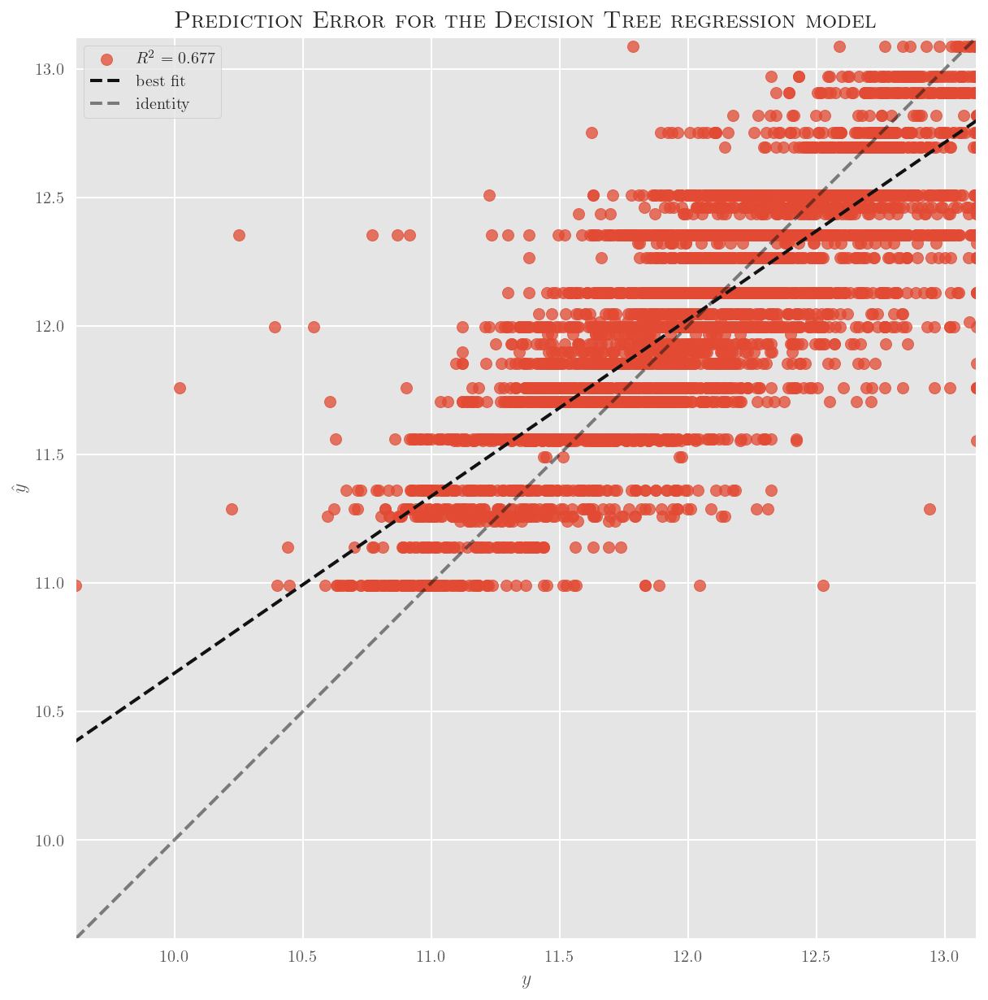

In [38]:
from yellowbrick.regressor import prediction_error

visualizer = prediction_error(tree_model, X_train, y_train, X_test, y_test,
                             title=r'\textsc{\Large Prediction Error for the Decision Tree regression model}',
                             xlabel=r'$\mathbf{y}$', ylabel=r'$\mathbf{\hat{y}}$')

## Random Forest Regressor

Let us now try to use the random-forest regressor

In [39]:
X.describe(include='all').transpose()

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
longitude,20433.0,NaN,NaN,NaN,-119.570689,2.003578,-124.35,-121.8,-118.49,-118.01,-114.31
latitude,20433.0,NaN,NaN,NaN,35.633221,2.136348,32.54,33.93,34.26,37.72,41.95
housing_median_age,20433.0,NaN,NaN,NaN,28.633094,12.591805,1.0,18.0,29.0,37.0,52.0
total_rooms,20433.0,NaN,NaN,NaN,7.628742,0.751814,0.693147,7.279319,7.662468,8.052933,10.579489
total_bedrooms,20433.0,NaN,NaN,NaN,6.051063,0.732785,0.0,5.690359,6.075346,6.472346,8.77106
population,20433.0,NaN,NaN,NaN,7.023732,0.738632,1.098612,6.668228,7.061334,7.451242,10.482402
households,20433.0,NaN,NaN,NaN,5.980637,0.733216,0.0,5.63479,6.013715,6.403574,8.713089
median_income,20433.0,NaN,NaN,NaN,1.244626,0.470637,-0.693347,0.941452,1.263138,1.556881,2.708057
ocean_proximity_<1H OCEAN,20433,2,False,11399,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ocean_proximity_INLAND,20433,2,False,13937,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [40]:
y.describe(include='all').transpose()

count    20433.000000
mean        12.084862
std          0.569222
min          9.615739
25%         11.691072
50%         12.099044
75%         12.486352
max         13.122365
Name: median_house_value, dtype: float64

In [41]:
from sklearn.ensemble import RandomForestRegressor

# Let us start with a lot of learners, and train the model

forest_model  = RandomForestRegressor(n_estimators = 1000, 
                                      n_jobs = 20, 
                                      random_state = 42).fit(X_train, y_train);


### Predictions and its metrics

In [42]:
labels = forest_model.predict(X_test)

# Check how good are the predictions?
mse         = mean_squared_error(y_test, labels)
print(f"Mean squared error: {mse:.2f}")
r2 = r2_score(y_test, labels)
print(rf"Coefficient of Determination (R^2):{r2:0.4f}")

Mean squared error: 0.05
Coefficient of Determination (R^2):0.8365


## Goodness of model diagnostics
Let us now see if the diagnostics on the model are indicating a good model

### Residuals Check
Let us plot the residuals to see if we have homoscedasticity

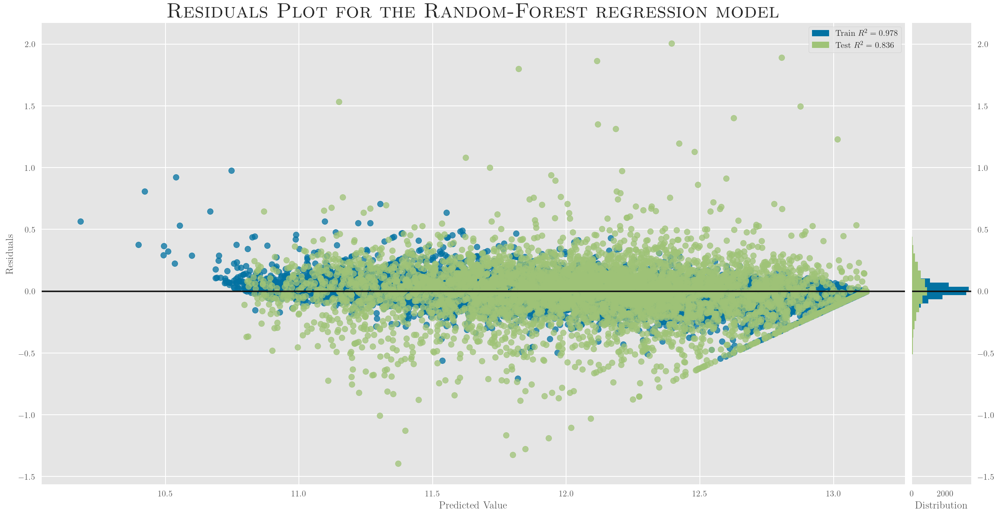

In [43]:
rc ('text', usetex=True) # Enable it selectively

from yellowbrick.regressor import residuals_plot
plt.rcParams[ 'figure.figsize' ] = '20,10'               # landscape format figures
viz = residuals_plot(forest_model, X_train, y_train, X_test, y_test, 
                     title=r'\textsc{\Huge Residuals Plot for the Random-Forest regression model}')

### Prediction Errors Plot

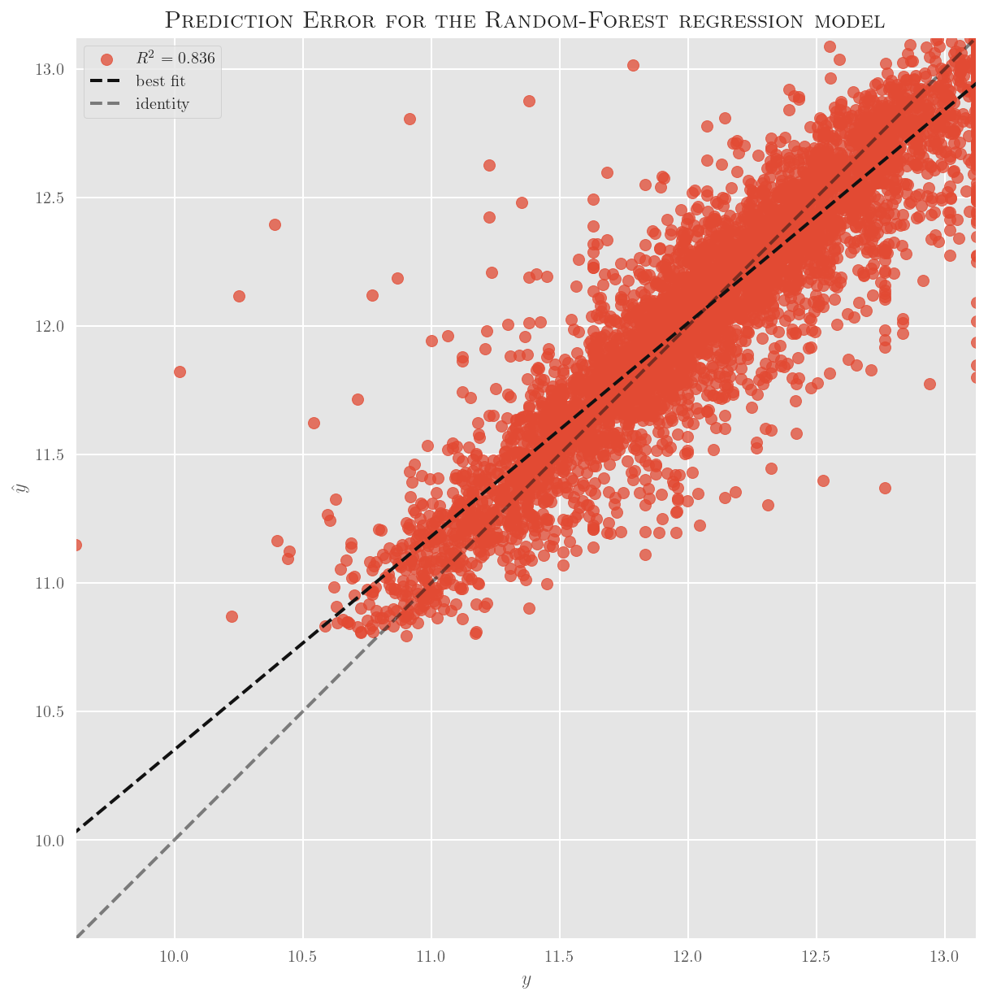

In [44]:
from yellowbrick.regressor import prediction_error

visualizer = prediction_error(forest_model, X_train, y_train, X_test, y_test,
                             title=r'\textsc{\Large Prediction Error for the Random-Forest regression model}',
                             xlabel=r'$\mathbf{y}$', ylabel=r'$\mathbf{\hat{y}}$')

## Visualizing one of the trees in the forest

Let us now visualize the decision tree that we have built.

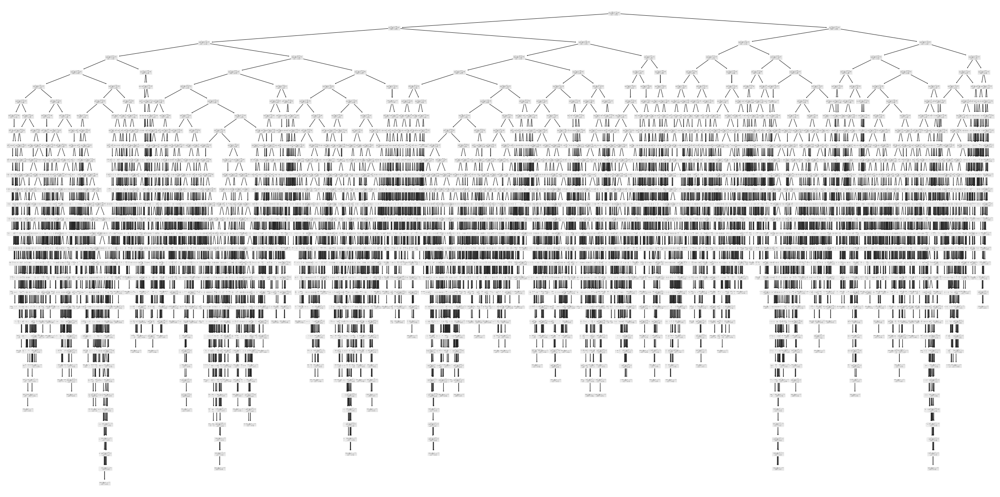

In [45]:
from sklearn.tree import plot_tree
plot_tree(forest_model.estimators_[0]);

## Feature Importance

Let us now consider the importance of each of the features in the model. Remember that this is only a global, rough average! We must use more robust methods to know what features are important in a given local region. More on that in the next workshop!

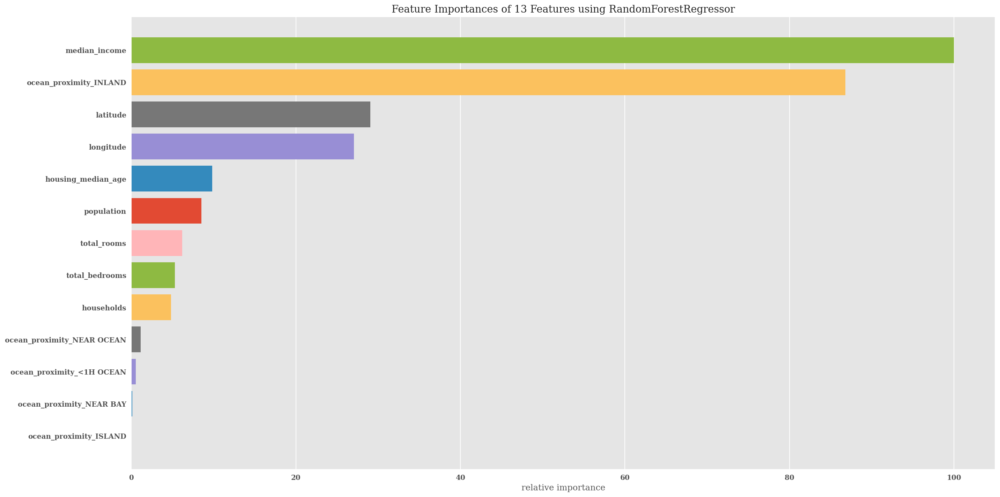

In [46]:
rc ('text', usetex=False) # disable (some features have _ in their names : it throws latex off)
from yellowbrick.model_selection import feature_importances
feature_importances(forest_model, X, y);

### Shapley Values

In [47]:
# import shap library
! pip install -q shap
import shap

In [48]:
# explain the model's predictions using SHAP
explainer = shap.TreeExplainer(forest_model)
sample = X_train.sample(1000)
shap_values = explainer.shap_values(sample)

# visualize the first prediction's explanation 
#shap.initjs()
#shap.force_plot(explainer.expected_value, shap_values[0,:], X_train.iloc[0,:])

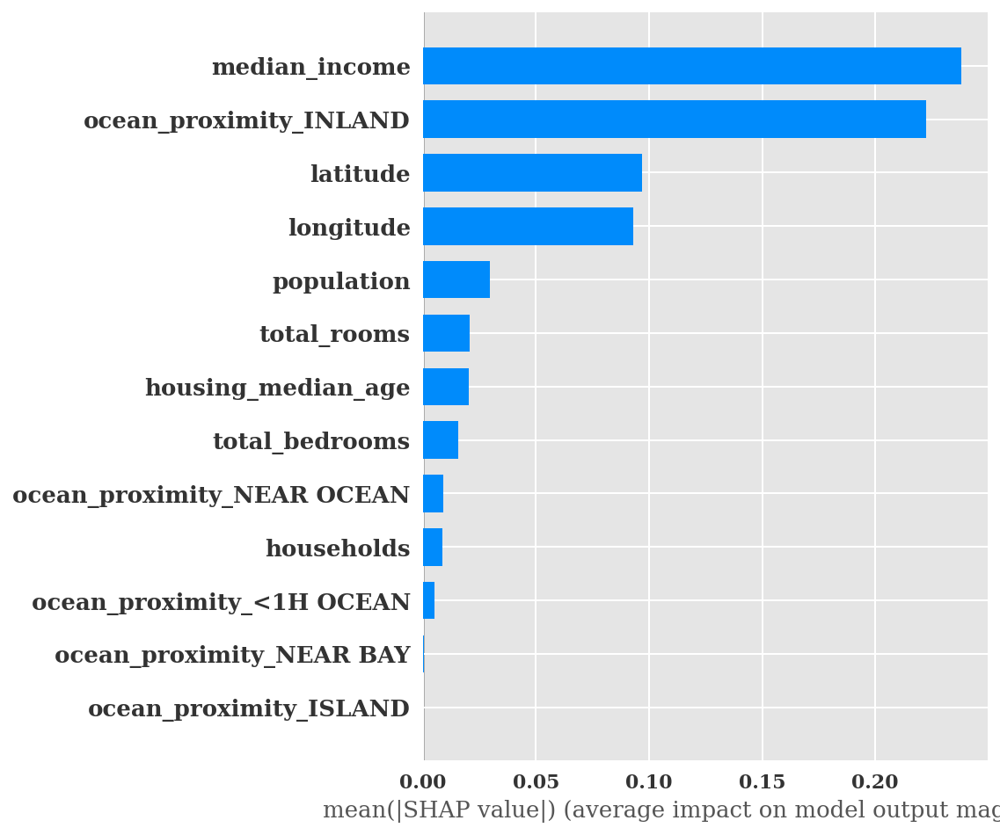

In [49]:

shap.summary_plot(shap_values, sample, plot_type="bar")

In [50]:
# Let us consider a random row!
row = np.random.randint(0, shap_values.shape[0])
print (f'We are going to look at the feature importance for the point in feature space given by data instance: {row}')


We are going to look at the feature importance for the point in feature space given by data instance: 168


In [51]:
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[row,:], X_train.iloc[row,:])

### Visualize the Shapley values  force plot

In [52]:

shap.force_plot(explainer.expected_value, shap_values, X_train)